<a href="https://colab.research.google.com/github/NJain121442/course2020/blob/master/17August_SEM_UNET_V1_M0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [19]:
import torch.nn as nn
import glob
from torch.utils.data import Dataset, DataLoader
import torch
import torch.nn.functional as F
import torch.optim as optim
from IPython.display import clear_output
from torchvision import datasets, transforms
import numpy as np
from torchsummary import summary 
import matplotlib.image as mpimg
import torchvision
from PIL import Image
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow

In [20]:
#from google.colab import drive 
#drive.mount("/content/drive")

In [21]:
!unzip /content/M0_120_class_images.zip -d /content/

Archive:  /content/M0_120_class_images.zip
replace /content/M0_Selected_class_images/Defect_103973_Class_1_Internal.tiff? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: /content/M0_Selected_class_images/Defect_103973_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_105326_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_105665_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_107357_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_107695_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_109387_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_111079_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_111418_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_111756_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_113786_Class_1_Inte

In [22]:
#!unzip '/content/drive/My Drive/AutoEncoder_training.zip' -d '/content/drive/My Drive/AutoEncoder_training' 

In [23]:
#!unzip '/content/drive/My Drive/HKMG-FI_180_class_images.zip' -d '/content/drive/My Drive/'

In [24]:
#Data_path = "/content/Fruits/"
#Data_path = "/content/drive/My Drive/AutoEncoder_training/AutoEncoder_training/"
#Data_path = "/content/drive/My Drive/All_class_images"
Data_path = "/content/M0_Selected_class_images"

In [25]:
#filelist = glob.glob(Data_path+'/*.jfif')
filelist = glob.glob(Data_path+'/*.tiff')

In [26]:
len(filelist)

120

Lets Resize all images to same size

In [27]:
class CustomDataset(Dataset):
  def __init__(self,path,new_size = 226):
    #self.filelist = glob.glob(path+'/*.jfif')
    self.filelist = glob.glob(path+'/*.tiff')
    self.new_size = new_size

  def __len__(self):
    return len(self.filelist)

  def __getitem__(self, idx):
    temp_filepath = self.filelist[idx]
    temp_image = cv2.imread(temp_filepath)
    #print(temp_image)
    #print('Original Dimensions : ',temp_image.shape)
    #cv2_imshow(temp_image)
    temp_image = cv2.cvtColor(temp_image, cv2.COLOR_BGR2GRAY)
    #print('Original Dimensions : ',temp_image.shape)
    #cv2_imshow(temp_image)
    #dim = (504,504)
    #temp_image = cv2.resize(temp_image, dim, interpolation = cv2.INTER_AREA)
    #print('Resized Dimensions : ',temp_image.shape)
    #cv2_imshow(temp_image)
    #print(temp_image.shape)
    temp_image = temp_image/255
    #plt.imshow(temp_image,cmap='gray',vmin=0,vmax=1)
    #temp_image = torch.from_numpy(temp_image)
    temp_image = torch.Tensor(temp_image)
    #print(temp_image.shape)
    #print(temp_image)
    temp_image = temp_image.unsqueeze(0)
    #print(temp_image.shape)
    return temp_image

In [28]:
Data = CustomDataset(Data_path)
Data[2].shape

torch.Size([1, 504, 504])

In [29]:
latent_dim = 128

class Encoder(nn.Module):
    def __init__(self):
        super(Encoder,self).__init__()
        self.enc1 = nn.Conv2d(1,64,kernel_size=3,stride=3)
        self.enc2 = nn.Conv2d(64,128,kernel_size=3,stride=3)
        self.enc3 = nn.Conv2d(128,256,kernel_size=2,stride=3)
        self.pool = nn.MaxPool2d(2,2,return_indices=True)
        self.FC1 = nn.Linear(6400,1024)
        self.FC2 = nn.Linear(1024,latent_dim)

    def forward(self,x):
        conv1 = F.relu(self.enc1(x)) # output will be 168x168x64
        x,indices1 = self.pool(conv1) #output will be 84x84x64
        conv2 = F.relu(self.enc2(x)) #output will be 28x28x128
        x,indices2 = self.pool(conv2)   # output will be 14x14x128
        conv3 = F.relu(self.enc3(x)) #output will be 5x5x256 
        x = conv3.view(-1,6400) # after flattening the size will be 6400
        x = F.relu(self.FC1(x))
        x = F.relu(self.FC2(x)) # the latent space representation
        return x,indices1,indices2,conv3,conv2,conv1
    
class Decoder(nn.Module):
    def __init__(self):
        super(Decoder,self).__init__()
        self.FC3 = nn.Linear(latent_dim,1024)
        self.FC4 = nn.Linear(1024,6400)
        self.dec1 = nn.ConvTranspose2d(256 + 256,128, kernel_size=2, stride=3)  
        self.dec2 = nn.ConvTranspose2d(128 + 128,64, kernel_size=3, stride=3)
        self.dec3 = nn.ConvTranspose2d(64 + 64 ,1, kernel_size=3, stride=3)
        self.unpool = nn.MaxUnpool2d(2,2,padding=0)
        
        
    def forward(self,x,indices1,indices2,conv3,conv2,conv1):
        x = F.relu(self.FC3(x)) #size back to 1024
        x = F.relu(self.FC4(x)) #size back to 6400
        x = torch.reshape(x,(1,256,5,5))
        x = torch.cat([x,conv3],dim=1)
        x = F.relu(self.dec1(x)) # ouput will be 14x14x128
        x = self.unpool(x,indices2) #output will be 28x28x128
        x = torch.cat([x,conv2],dim=1)
        x = F.relu(self.dec2(x)) # output will be 84x84x64
        x = self.unpool(x,indices1) #output will be 168x168x64
        x = torch.cat([x,conv1],dim=1)
        #x = self.dec3(x) # output will be 504x504x1
        x = torch.sigmoid(self.dec3(x)) # output will be 504x504x1
        return x
    
class Conv2d_AutoEncoder(nn.Module):
    def __init__(self):
        super(Conv2d_AutoEncoder, self).__init__()

        self.enc = Encoder()
        self.dec = Decoder()

    def forward(self, x):
        
        z,indices1,indices2,conv3,conv2,conv1 = self.enc(x)
        
        out = self.dec(z,indices1,indices2,conv3,conv2,conv1)
        
        return out

**Lets write the first Auto encoder **

In [30]:
net = Conv2d_AutoEncoder()
print(net)
if torch.cuda.is_available():
    net.cuda()
#summary(net,input_size=(1,504,504))

Conv2d_AutoEncoder(
  (enc): Encoder(
    (enc1): Conv2d(1, 64, kernel_size=(3, 3), stride=(3, 3))
    (enc2): Conv2d(64, 128, kernel_size=(3, 3), stride=(3, 3))
    (enc3): Conv2d(128, 256, kernel_size=(2, 2), stride=(3, 3))
    (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (FC1): Linear(in_features=6400, out_features=1024, bias=True)
    (FC2): Linear(in_features=1024, out_features=128, bias=True)
  )
  (dec): Decoder(
    (FC3): Linear(in_features=128, out_features=1024, bias=True)
    (FC4): Linear(in_features=1024, out_features=6400, bias=True)
    (dec1): ConvTranspose2d(512, 128, kernel_size=(2, 2), stride=(3, 3))
    (dec2): ConvTranspose2d(256, 64, kernel_size=(3, 3), stride=(3, 3))
    (dec3): ConvTranspose2d(128, 1, kernel_size=(3, 3), stride=(3, 3))
    (unpool): MaxUnpool2d(kernel_size=(2, 2), stride=(2, 2), padding=(0, 0))
  )
)


In [31]:
train_loader = DataLoader(Data,batch_size=1)

In [32]:
loss_func = nn.MSELoss()
#loss_func = nn.L1Loss()
optimizer = optim.Adam(net.parameters(), lr=0.0001) 


Training the Auto encoder

In [33]:
!pip install kornia
from kornia import filters

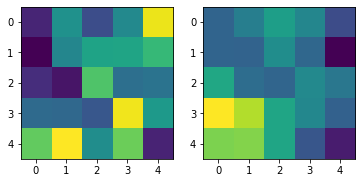

In [34]:
input = torch.rand(2, 4, 5, 5)
fig,ax = plt.subplots(1,2)
ax[0].imshow(input[0][0])
SpatialGradient = filters.SpatialGradient()
output = SpatialGradient(input)
ax[1].imshow(output[0][0][1])

In [35]:
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt

n_epochs = 200

if torch.cuda.is_available():
    net.cuda()
total_loss = []

epoch_loss = 0
net.train()
for epoch in tqdm(range(n_epochs)):
    print("current epoch is:",epoch)
    epoch_loss = 0
    for x in train_loader:
        mse_loss = 0
        loss_der = 0
        if torch.cuda.is_available():
          x = x.cuda()
        optimizer.zero_grad()
        prediction = net(x)
        loss_der = loss_func(SpatialGradient(prediction), SpatialGradient(x))
        mse_loss = loss_func(prediction, x) # <-- note that i'm using the input as the target
        (mse_loss+loss_der).backward()
        optimizer.step()
        epoch_loss = epoch_loss + mse_loss.item() + loss_der.item()

        
    #clear_output(wait=True)
    total_loss.append(epoch_loss)
    print('Loss Per epoch: ',epoch_loss)

current epoch is: 0
Loss Per epoch:  7.347873200196773
current epoch is: 1
Loss Per epoch:  5.6609922014176846
current epoch is: 2
Loss Per epoch:  4.305471477797255
current epoch is: 3
Loss Per epoch:  3.3734535557450727
current epoch is: 4
Loss Per epoch:  2.8125702128745615
current epoch is: 5
Loss Per epoch:  2.4078027063515037
current epoch is: 6
Loss Per epoch:  2.104318655678071
current epoch is: 7
Loss Per epoch:  1.863211319083348
current epoch is: 8
Loss Per epoch:  1.660325841861777
current epoch is: 9
Loss Per epoch:  1.4867125822929665
current epoch is: 10
Loss Per epoch:  1.3397869147593156
current epoch is: 11
Loss Per epoch:  1.2094310418469831
current epoch is: 12
Loss Per epoch:  1.0915228803060018
current epoch is: 13
Loss Per epoch:  0.9838896691217087
current epoch is: 14
Loss Per epoch:  0.8853731418494135
current epoch is: 15
Loss Per epoch:  0.7955032135359943
current epoch is: 16
Loss Per epoch:  0.7135175002622418
current epoch is: 17
Loss Per epoch:  0.639238

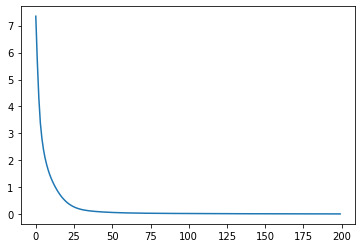

In [36]:
import matplotlib.pyplot as plt
plt.plot(total_loss)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


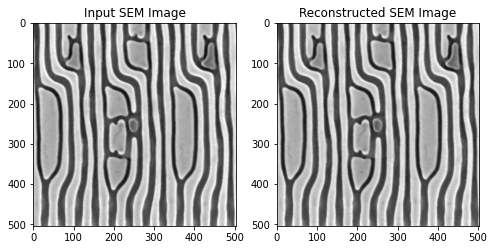

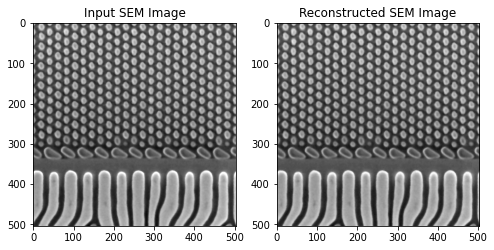

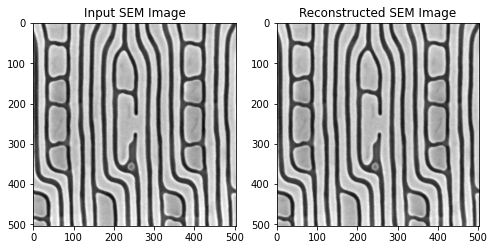

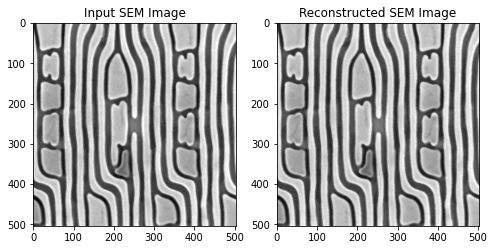

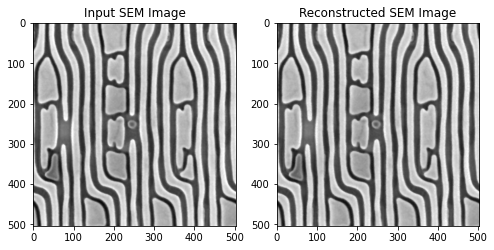

...

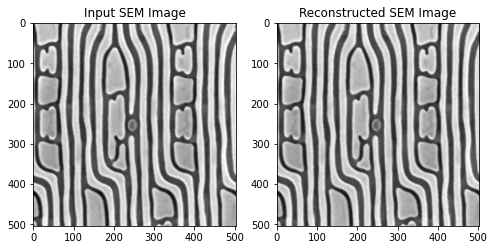

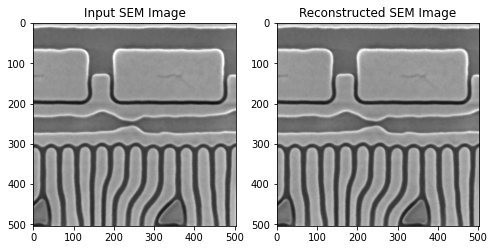

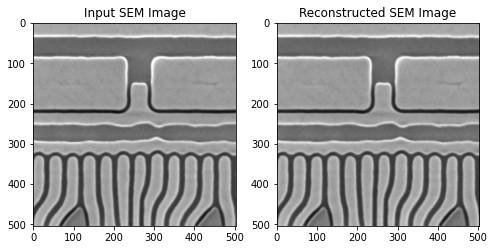

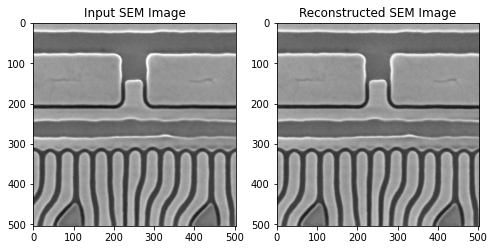

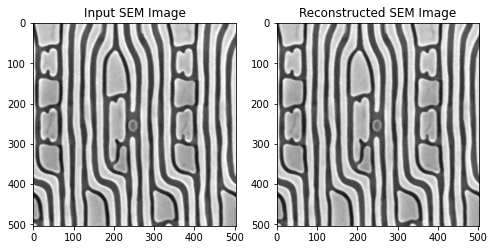

In [37]:
net.cpu()
net.eval()
counter = 0
for i in range(30):
    counter = counter + 1
    fig,ax = plt.subplots(1,2,figsize=(8,4))
    x = Data[i]
    input_img = x[0]
    #print(input_img)
    model_pred = net(x.unsqueeze(0))[0].cpu().data.numpy()[0]
    #print(model_pred)
    ax[0].set_title('Input SEM Image',fontsize=12)
    ax[1].set_title('Reconstructed SEM Image',fontsize=12)
    ax[0].imshow(input_img,cmap='gray',vmin=0,vmax=1)
    ax[1].imshow(model_pred,cmap='gray',vmin=0,vmax=1)


Extract Latent representation from Encoder 

Do Clustering and calculate Silhouette Score

In [38]:
from sklearn.cluster import KMeans
from sklearn import preprocessing
from sklearn.metrics import silhouette_samples, silhouette_score
Encoder_net = Encoder()
Attributes = np.empty([len(train_loader),latent_dim])
#print(Attributes.shape)
for i,x in enumerate(Data):
  Temp_results = Encoder_net(x.unsqueeze(0))
  #print(Temp_results[0])
  Temp_Attributes = (Temp_results[0]).cpu().data.numpy()
  #print("Temp_Attributes:",Temp_Attributes)
  Attributes[i] = Temp_Attributes
  #print(Attributes[i].shape)
print(Attributes.shape)
print(Attributes)

(120, 128)
[[0.030644   0.02778835 0.02485549 ... 0.00258163 0.         0.        ]
 [0.02438267 0.02952692 0.02503381 ... 0.00143705 0.         0.        ]
 [0.02374494 0.02517929 0.02361147 ... 0.00206432 0.         0.        ]
 ...
 [0.0239058  0.03024167 0.02849684 ... 0.         0.         0.        ]
 [0.02835788 0.02548149 0.02580167 ... 0.00547729 0.         0.        ]
 [0.02551251 0.02731051 0.02553273 ... 0.00370145 0.         0.        ]]


In [39]:
from sklearn.feature_selection import VarianceThreshold
k=7
Attributes_scaled = preprocessing.scale(Attributes)
print(Attributes_scaled.shape)
#print(Attributes_scaled.mean(axis=0))
print(Attributes_scaled.std(axis=0))
selector = VarianceThreshold()
Attributes_scaled = selector.fit_transform(Attributes_scaled)
print(Attributes_scaled.shape)
#print(Attributes_scaled.mean(axis=0))
print(Attributes_scaled.std(axis=0))
kmeans = KMeans(n_clusters=k,random_state=0).fit(Attributes_scaled)
Clustering_labels = kmeans.labels_
print(Clustering_labels)
Score = silhouette_score(Attributes_scaled,Clustering_labels,metric='euclidean')
print(Score)
sample_score = silhouette_samples(Attributes_scaled,Clustering_labels,metric='euclidean')
#print(sample_score)

(120, 128)
[1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 0. 1. 1. 1. 1. 1. 1. 0.
 0. 0. 0. 1. 0. 1. 1. 0. 1. 1. 0. 0. 1. 1. 0. 1. 0. 0. 1. 1. 1. 1. 0. 0.
 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 1. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 1. 1.
 0. 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0.
 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0.
 0. 1. 1. 1. 0. 1. 0. 0.]
(120, 66)
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[1 0 3 4 3 3 3 3 3 2 3 4 0 3 5 6 2 4 0 1 2 3 3 5 2 3 6 5 6 3 6 6 3 0 3 2 2
 6 3 3 5 6 3 6 2 0 2 6 3 0 5 2 3 1 2 5 4 3 3 5 3 4 0 6 6 5 4 2 6 2 0 6 4 1
 6 1 2 4 2 6 3 0 5 0 3 0 3 3 5 0 5 4 2 2 5 0 3 6 6 0 6 2 0 5 6 0 5 0 6 2 4
 3 0 2 2 4 2 0 4 2]
0.13128193153062592


In [40]:
max(sample_score)

0.33231188002709255

Find Optimal K using Silhouette score

[0.21153366 0.15427639 0.12072164 0.13146125 0.13523349 0.13128193
 0.14033003 0.11914178 0.10595787 0.11217678 0.10165475 0.09517432
 0.11061937 0.11018865 0.10244431 0.10422763 0.10936402 0.10952929
 0.11552986 0.13013304]
[6114.767782324361, 5675.686398274849, 5345.689145881886, 5008.790137459472, 4799.569128394116, 4648.1555724157515, 4396.9359693895, 4302.803526303193, 4233.890814645704, 4123.292044655427, 3966.1279678042333, 3871.6472731747726, 3747.3660917638076, 3633.0491592180374, 3533.007898944542, 3382.3023436697113, 3293.6983549536476, 3219.8120267767017, 3113.770042271919, 2997.699684240559]
2


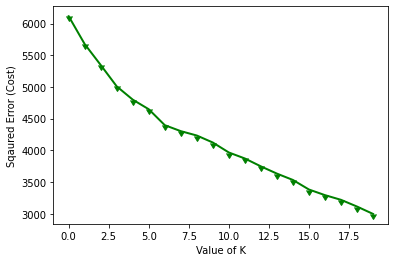

In [41]:
cost = []
k_range = 20
Score = np.empty(20)
for k in range(k_range):
  kmeans = KMeans(n_clusters=k+2,random_state=0).fit(Attributes_scaled)
  cost.append(kmeans.inertia_)
  Clustering_labels_k = kmeans.labels_
  Score[k] = silhouette_score(Attributes_scaled,Clustering_labels_k,metric='euclidean')
print(Score)
print(cost)
Max_score_k = np.argmax(Score) + 2
print(Max_score_k)
plt.plot(cost, color ='g', linewidth ='2',marker = 11) 
plt.xlabel("Value of K") 
plt.ylabel("Sqaured Error (Cost)") 
plt.show() # clear the plot 



In [42]:
import pandas as pd 
column_names = ["Image","Label","sample_score"]
df = pd.DataFrame(columns = column_names,index=np.arange(len(Data)))
df['Image'][88]

for i,x in enumerate(Data):
  df['Image'][i] = (x[0]).data.numpy()
  df['Label'][i] = Clustering_labels[i]
  df['sample_score'][i] = sample_score[i]
  #print(input_img)

In [43]:
df

,Image,Label,sample_score
0,"[[0.36078432, 0.3254902, 0.28627452, 0.2549019...",1,0.21798
1,"[[0.72156864, 0.7372549, 0.7529412, 0.7529412,...",0,0.0288757
2,"[[1.0, 0.9843137, 0.95686275, 0.92941177, 0.90...",3,0.247451
3,"[[0.3137255, 0.25490198, 0.19215687, 0.1333333...",4,0.0306879
4,"[[0.61960787, 0.54509807, 0.42352942, 0.325490...",3,0.207734
...,...,...,...
115,"[[0.90588236, 0.9137255, 0.93333334, 0.9568627...",4,0.00910068
116,"[[0.8980392, 0.92156863, 0.95686275, 0.9843137...",2,0.202658
117,"[[0.5568628, 0.5372549, 0.49411765, 0.42745098...",0,0.145775
118,"[[0.99215686, 0.98039216, 0.95686275, 0.878431...",4,-0.0358308


In [44]:
df= df.sort_values('Label',ignore_index=True)
print(df)
df['Image'][80]

                                                 Image Label sample_score
0    [[0.7176471, 0.7176471, 0.7137255, 0.70980394,...     0     0.169874
1    [[0.8666667, 0.8745098, 0.88235295, 0.8627451,...     0    0.0882022
2    [[0.69803923, 0.67058825, 0.60784316, 0.458823...     0    0.0905718
3    [[0.9647059, 0.9764706, 0.9882353, 0.9843137, ...     0     0.178469
4    [[0.7372549, 0.6156863, 0.44313726, 0.38431373...     0   0.00291852
..                                                 ...   ...          ...
115  [[0.6627451, 0.67058825, 0.6745098, 0.6784314,...     6     0.140249
116  [[0.42745098, 0.41960785, 0.41568628, 0.415686...     6    0.0171137
117  [[0.6627451, 0.6627451, 0.65882355, 0.654902, ...     6     0.152349
118  [[0.63529414, 0.6313726, 0.627451, 0.627451, 0...     6     0.180996
119  [[0.6392157, 0.6313726, 0.627451, 0.627451, 0....     6     0.116008

[120 rows x 3 columns]


array([[0.99215686, 0.98039216, 0.95686275, ..., 0.9254902 , 0.9372549 ,
        0.94509804],
       [0.99215686, 0.98039216, 0.95686275, ..., 0.9254902 , 0.9372549 ,
        0.94509804],
       [0.9843137 , 0.972549  , 0.94509804, ..., 0.91764706, 0.93333334,
        0.94509804],
       ...,
       [0.9882353 , 0.99215686, 0.9843137 , ..., 0.9411765 , 1.        ,
        1.        ],
       [0.99607843, 1.        , 1.        , ..., 0.9372549 , 1.        ,
        1.        ],
       [1.        , 1.        , 1.        , ..., 0.92941177, 1.        ,
        1.        ]], dtype=float32)

120


<function matplotlib.pyplot.show>

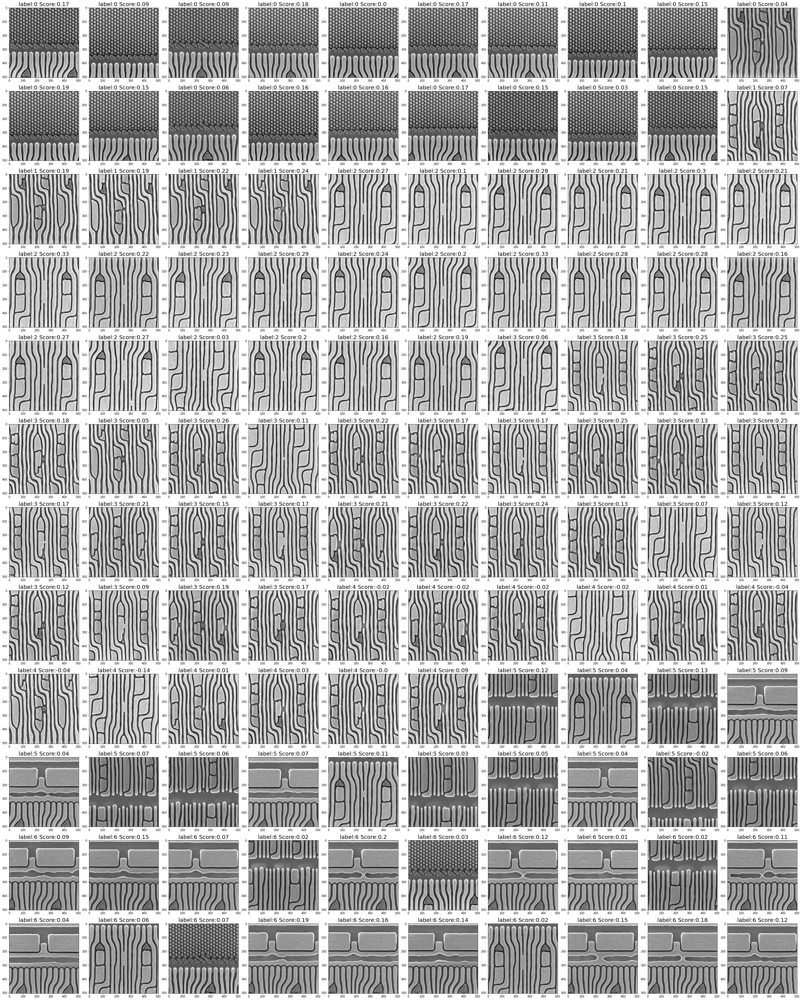

In [46]:
ncols = 10
print(len(Data))
nrows = int(len(Data)/ncols)
figsize = [40,50]  
fig,ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
axi = ax.flat
#print(len(axi))
for i,x in enumerate(Data):
  input_img = df['Image'][i]
  axi[i].set_title("label:"+str(df['Label'][i])+" "+"Score:"+str(round(df['sample_score'][i],2)),fontsize =20)
  #plt.title('Input SEM Image',fontsize=6)
  axi[i].imshow(input_img,cmap='gray',vmin=0,vmax=1)
fig.tight_layout(pad=0.3)
plt.show

In [51]:
df['Image']
df['Image'].size

120

In [71]:
dim = (72,72)
X = np.empty([len(train_loader),72*72])
for i in range(df['Image'].size):
  temp_image = df['Image'][i]
  temp_image = cv2.resize(temp_image, dim)
  X[i] = temp_image.flatten()

In [73]:
X.shape

(120, 5184)

In [75]:
from sklearn.feature_selection import VarianceThreshold
k=7
Attributes_scaled = preprocessing.scale(X)
print(X.shape)
#print(X.mean(axis=0))
print(X.std(axis=0))
selector = VarianceThreshold()
Attributes_scaled = selector.fit_transform(Attributes_scaled)
print(Attributes_scaled.shape)
#print(Attributes_scaled.mean(axis=0))
print(Attributes_scaled.std(axis=0))
kmeans = KMeans(n_clusters=k,random_state=0).fit(Attributes_scaled)
Clustering_labels_NEW = kmeans.labels_
print(Clustering_labels)
Score = silhouette_score(Attributes_scaled,Clustering_labels,metric='euclidean')
print(Score)
sample_score_NEW = silhouette_samples(Attributes_scaled,Clustering_labels,metric='euclidean')
#print(sample_score)

(120, 5184)
[0.24552275 0.25229923 0.22971308 ... 0.25716093 0.23437011 0.22346931]
(120, 5184)
[1. 1. 1. ... 1. 1. 1.]
[4 4 4 4 4 4 4 4 4 6 4 4 4 4 4 4 4 4 4 3 3 2 3 3 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 5 0 0 0 0 1 3 3 3 3 3 5 3 3 1 3 3 1 1 3 3 1 3 1 3 3 0 1 3 1 3 3
 2 2 2 5 2 2 2 5 2 2 2 2 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6
 6 6 6 6 6 6 6 6 6]
0.18449631446778333


In [78]:
import pandas as pd 
column_names = ["Image","Label","sample_score"]
df = pd.DataFrame(columns = column_names,index=np.arange(len(Data)))
df['Image'][88]

for i,x in enumerate(Data):
  df['Image'][i] = (x[0]).data.numpy()
  df['Label'][i] = Clustering_labels_NEW[i]
  df['sample_score'][i] = sample_score_NEW[i]
df= df.sort_values('Label',ignore_index=True)

120


<function matplotlib.pyplot.show>

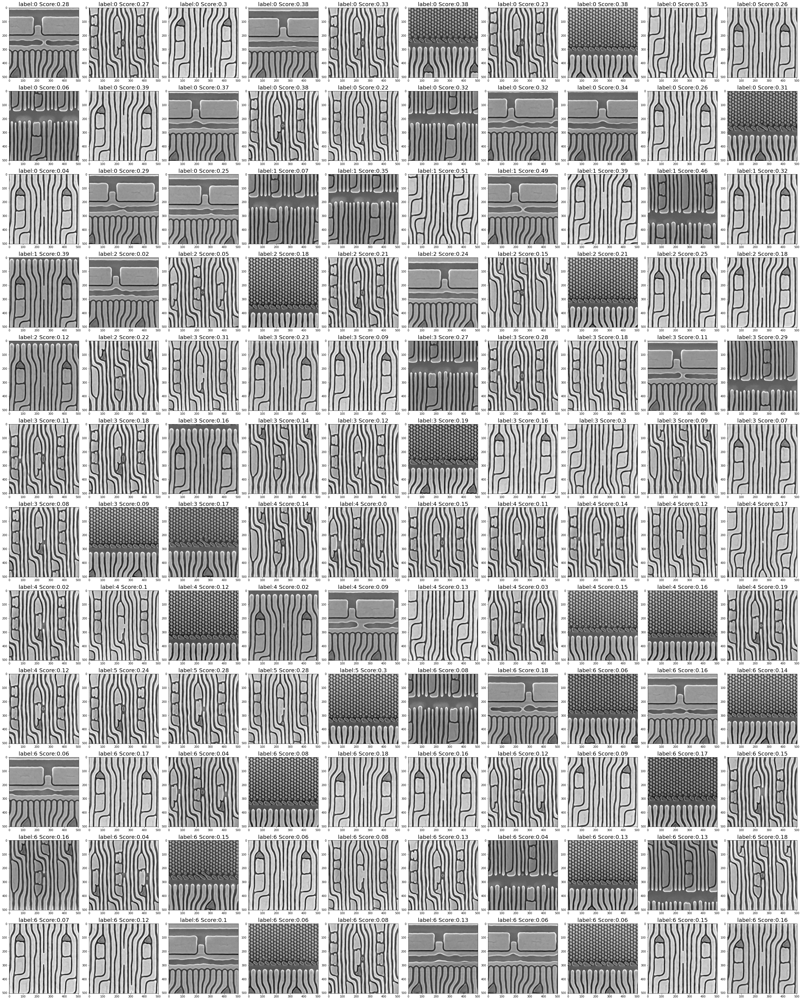

In [79]:
ncols = 10
print(len(Data))
nrows = int(len(Data)/ncols)
figsize = [40,50]  
fig,ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
axi = ax.flat
#print(len(axi))
for i,x in enumerate(Data):
  input_img = df['Image'][i]
  axi[i].set_title("label:"+str(df['Label'][i])+" "+"Score:"+str(round(df['sample_score'][i],2)),fontsize =20)
  #plt.title('Input SEM Image',fontsize=6)
  axi[i].imshow(input_img,cmap='gray',vmin=0,vmax=1)
fig.tight_layout(pad=0.3)
plt.show